# DNA/RNA Virus Toolklit

## Import needed Python libraries

In [55]:
from tqdm import tqdm
import time
import pandas as pd
import numpy as np
import random
from collections import Counter
import os, sys, traceback

from Bio import SeqIO
from Bio.Seq import Seq
from Bio.SeqUtils.ProtParam import ProteinAnalysis
from Bio.Alphabet import generic_dna

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.decomposition import TruncatedSVD
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

import nltk
from nltk.util import ngrams
from nltk import word_tokenize

plt.style.use('ggplot')

## Structures needed in genome analysis

In [259]:
nucleotides = ["A", "T", "C", "G"]
proteins = ['A','D','E','G','F','L','S','Y','C','W','L','P','H','Q','R','I','M','T','N','K','S','R','V']
complements = {"A": "T", "T": "A", "G": "C", "C": "G"}
uncertainties = ['W', 'U', 'S', 'M', 'K', 'R', 'Y', 'B', 'D', 'H', 'V', 'N', 'Z']
amino_acids = {
    'alanine': 'A', 'arginine': 'R', 'Asparagine': 'N', 'Aspartic Acid': 'D',
    'Cysteine': 'C', 'Glutamic Acid': 'E', 'Glutamine': 'Q',
    'Glycine': 'G', 'Histidine': 'H', 'Isoleucine': 'I', 'Leucine': 'L',
    'Lysine': 'K', 'Methionine': 'M', 'Phenylalanine': 'F', 'Proline': 'P',
    'Serine': 'S', 'Threonine': 'T', 'Tryptophan': 'W', 'Tyrosine': 'Y',
    'Valine': 'V'
}

# using mRNA in lookup, not tRNA anti-codon
start_codons = ["ATG"]
stop_codons = ["TAA", "TAG", "TGA"]
dna_codons = {
    # 'M' - START, '_' - STOP
    "GCT": "A", "GCC": "A", "GCA": "A", "GCG": "A",
    "TGT": "C", "TGC": "C",
    "GAT": "D", "GAC": "D",
    "GAA": "E", "GAG": "E",
    "TTT": "F", "TTC": "F",
    "GGT": "G", "GGC": "G", "GGA": "G", "GGG": "G",
    "CAT": "H", "CAC": "H",
    "ATA": "I", "ATT": "I", "ATC": "I",
    "AAA": "K", "AAG": "K",
    "TTA": "L", "TTG": "L", "CTT": "L", "CTC": "L", "CTA": "L", "CTG": "L",
    "ATG": "M",
    "AAT": "N", "AAC": "N",
    "CCT": "P", "CCC": "P", "CCA": "P", "CCG": "P",
    "CAA": "Q", "CAG": "Q",
    "CGT": "R", "CGC": "R", "CGA": "R", "CGG": "R", "AGA": "R", "AGG": "R",
    "TCT": "S", "TCC": "S", "TCA": "S", "TCG": "S", "AGT": "S", "AGC": "S",
    "ACT": "T", "ACC": "T", "ACA": "T", "ACG": "T",
    "GTT": "V", "GTC": "V", "GTA": "V", "GTG": "V",
    "TGG": "W",
    "TAT": "Y", "TAC": "Y",
    "TAA": "_", "TAG": "_", "TGA": "_"
}

rna_codons = {
    # 'M' - START, '_' - STOP
    "GCU": "A", "GCC": "A", "GCA": "A", "GCG": "A",
    "UGU": "C", "UGC": "C",
    "GAU": "D", "GAC": "D",
    "GAA": "E", "GAG": "E",
    "UUU": "F", "UUC": "F",
    "GGU": "G", "GGC": "G", "GGA": "G", "GGG": "G",
    "CAU": "H", "CAC": "H",
    "AUA": "I", "AUU": "I", "AUC": "I",
    "AAA": "K", "AAG": "K",
    "UUA": "L", "UUG": "L", "CUU": "L", "CUC": "L", "CUA": "L", "CUG": "L",
    "AUG": "M",
    "AAU": "N", "AAC": "N",
    "CCU": "P", "CCC": "P", "CCA": "P", "CCG": "P",
    "CAA": "Q", "CAG": "Q",
    "CGU": "R", "CGC": "R", "CGA": "R", "CGG": "R", "AGA": "R", "AGG": "R",
    "UCU": "S", "UCC": "S", "UCA": "S", "UCG": "S", "AGU": "S", "AGC": "S",
    "ACU": "T", "ACC": "T", "ACA": "T", "ACG": "T",
    "GUU": "V", "GUC": "V", "GUA": "V", "GUG": "V",
    "UGG": "W",
    "UAU": "Y", "UAC": "Y",
    "UAA": "_", "UAG": "_", "UGA": "_"
}

BT006808_1 = "ATGGCCCTGTGGATGCGCCTCCTGCCCCTGCTGGCGCTGCTGGCCCTCTGGGGACCTGACCCAGCCGCAGCCTTTGTGAACCAACACCTGTGCGGCTCACACCTGGTGGAAGCTCTCTACCTAGTGTGCGGGGAACGAGGCTTCTTCTACACACCCAAGACCCGCCGGGAGGCAGAGGACCTGCAGGTGGGGCAGGTGGAGCTGGGCGGGGGCCCTGGTGCAGGCAGCCTGCAGCCCTTGGCCCTGGAGGGGTCCCTGCAGAAGCGTGGCATTGTGGAACAATGCTGTACCAGCATCTGCTCCCTCTACCAGCTGGAGAACTACTGCAACTAG"
MT324680_1 = "CAAKACTCACTTTCTTCCACAGCAAGTGCACTTGGAAAACTTCAAGATGTGGTCAACCAAAATGCACAAGCTTTAAACACGCTTGTTAAACAACTTAGCTCCAATTTTGGTGCAATTTCAAGTGTTTTAAATGATATCCTTTCACGTCTTGACAAAGTTGAGGCTGAAGTGCAAATTGATAGGTTGATCACAGGCAGACTTCAAAGTTTGCAGACATATGTGACTCAACAATTAATTAGAGCTGCAGAAATCAGAGCTTCTGCTAATCTTGCTGCTACTAAAATGTCAGAGTGTGTACTTGGACAATCAAAAAGAGTTGATTTTTGTGGAAAGGGCTATCATCTTATGTCCTTCCCTCAGTCAGCACCTCATGGTGTAGTCTTCTTGCATGTGACTTATGTCCCTGCACAAGAAAAGAACTTCACAACTGCTCCTGCCATTTGTCATGATGGAAAAGCACACTTTCCTCGTGAAGGTGTCTTTGTTTCAAA"

## Defined bioinformatic functions

In [60]:
def translateNucleotides(seq):
    seq = Seq(seq, generic_dna)
    translated_seq = str(seq.translate()).replace('*', '')
    clean_seq = ''.join([p for p in translated_seq if p in proteins])
    return clean_seq

In [61]:
def getVirusDf(fasta_data):
    try:
        ids = [] # accession id, searchable on NCBI
        descs = [] # text description of strain
        aa_percs = [] # ratio of amino acids in strain
        m_weights = [] # molecular weight
        a = [] # aromaticity
        ii = [] # instability index, > 40 means unstable / short half life .instability_index()
        n_seqs = [] # nuleotide sequence
        p_seqs = [] # translated protein sequence

        for record in tqdm(fasta_data):
            print(f'Processing {record.id} - {record.description}')
#             str_seq = cleanPlaceholderNucleotides(str(record.seq))
            str_seq = str(record.seq)
    
            # translated nucleotide string sequence
            p_seq = translateNucleotides(str_seq)
            ids.append(record.id)
            descs.append(record.description)
            
            # GC content
            gc_content = calcGcContent(str_seq)
            
            # protein analysis methods
            analysis = ProteinAnalysis(p_seq)
            aa_percs.append(analysis.get_amino_acids_percent())
            m_weights.append(analysis.molecular_weight())
            ii.append(analysis.instability_index())
            a.append(analysis.aromaticity())
            
            # nucleotide and protein string sequences
            n_seqs.append(str_seq)
            p_seqs.append(str(record.seq.translate()).replace('*', ' '))

        virus_df = pd.DataFrame({
            "ids": ids,
            "description": descs,
            "gc_content": gc_content,
            "amino_acid_percents": aa_percs,
            "molecular_weights": m_weights,
            "aromaticity": a,
            "instability_index": ii,
            "nucleotide_sequence": n_seqs,
            "protein_sequence": p_seqs
        })

        return virus_df
                  
    except Exception as e:
        print('-'*80)
        print(f"Exception in building virus datatframe: {e}")
        traceback.print_exc(file=sys.stdout)
        print('-'*80)

In [62]:
def proteinTranslation(x):
    return str(Seq(x).translate()).replace('*', ' ')

In [63]:
def proteinAnalysis(s):
    aa_percent, molecular_weight, instability_index, aromaticity = [], [], [], []
    for x in tqdm(s):
        protein_analysis = ProteinAnalysis(x.replace(' ', ''))
        aa_percent.append(protein_analysis.get_amino_acids_percent())
        molecular_weight.append(protein_analysis.molecular_weight())
        instability_index.append(protein_analysis.instability_index())
        aromaticity.append(protein_analysis.aromaticity())
    return aa_percent, molecular_weight, instability_index, aromaticity

In [64]:
def filterOutliers(df):
    q1 = df.seq_len.quantile(.25)
    q3 = df.seq_len.quantile(.75)
    iqr = q3 - q1
    
    lower_bound = q1 - iqr * 1.5
    upper_bound = q3 + iqr * 1.5
    
    print(f'Lower IQR bound: {lower_bound}, Upper IQR bound: {upper_bound}')
    
    return df[(df.seq_len<=upper_bound) & (df.seq_len>=lower_bound)].copy()

In [65]:
def removeStringBuffer(seq, i):
    out_seq = seq[:i-i%3] + seq[i+3-i%3:]
    return out_seq.replace('\n', '')

In [66]:
def cleanPlaceholderNucleotides(seq):
    k_pos = []
    for i in range(len(seq)):
        if seq[i] not in nucleotides:
            print(f'Found placeholder at {i}th nucleotide')
            k_pos.append(i)
    
    k_seq = seq
    if len(k_pos) > 0:
        for pos in k_pos:
            k_seq = removeStringBuffer(k_seq, pos)

    return k_seq[:(len(k_seq)-len(k_seq)%3)]

In [67]:
def buildAminoTriples(s):
    seq_list = []
    for i in range(0, len(s), 3):
        seq_list.append(s[i:i+3])
    return seq_list

In [68]:
def countNucleotides(seq):
#     a_num = seq.count('A')
#     t_num = seq.count('T')
#     c_num = seq.count('C')
#     g_num = seq.count('G')
#     gc_content = (c_num + g_num) / (c_num + g_num + a_num + c_num)
#     nuc_dict = {"A": a_num,
#                "T": t_num,
#                "C": c_num,
#                "G": g_num,
#                "GC": gc_content}
    nuc_dict = dict(Counter(seq))
    return nuc_dict

In [69]:
def validateString(seq):
    tmp_seq = seq.upper()
    for nuc in tmp_seq:
        if nuc not in nucleotides:
            return False
    return True

In [70]:
def generateRandomString(num_nucs):
    rand_seq = ''.join([random.choice(nucleotides) for nuc in range(num_nucs)])
    return rand_seq

In [71]:
def transcription(seq):
    return seq.replace("T", "U")

In [72]:
def reverseComplement(seq):
    return ''.join([complements[nuc] for nuc in seq])[::-1]

In [73]:
def calcGcContent(seq):
    return round((seq.count("C") + seq.count("G")) / len(seq) * 100, 3)

In [74]:
def subseqGcContent(seq, k=20):
    res = []
    for i in range(0, len(seq) - k + 1, k):
        subseq = seq[i:i + k]
        res.append(calcGcContent(subseq))
    return res

In [75]:
def translateSequence(seq, seq_type='dna', init_pos=0):
    if seq_type == 'dna':
        return [dna_codons[seq[pos:pos+3]] for pos in range(init_pos, len(seq) -2, 3)]
    elif seq_type == 'rna':
        return [rna_condons[seq[pos:pos+3]] for pos in range(init_pos, len(seq) -2, 3)]
    else:
        return ['invalid genome type provided']

In [76]:
def codonUsage(seq, aminoacid):
    codon_list = []
    for i in range(0, len(seq) - 2, 3):
        if dna_codons[seq[i:i + 3]] == aminoacid:
            codon_list.append(seq[i:i + 3])
            
    codon_frequencies = dict(Counter(codon_list))
    total_weight = sum(codon_frequencies.values())
    for seq in codon_frequencies:
        codon_frequencies[seq] = round(codon_frequencies[seq] / total_weight, 2)
    return codon_frequencies

In [77]:
def generateReadingFrames(seq):
    frames = []
    frames.append(translateSequence(seq, 'dna', 0))
    frames.append(translateSequence(seq, 'dna', 1))
    frames.append(translateSequence(seq, 'dna', 2))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 0))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 1))
    frames.append(translateSequence(reverseComplement(seq), 'dna', 2))
    return frames

In [78]:
def proteinsFromReadingFrame(amino_acids):
    current_protein = []
    proteins = []
    
    for amino_acid in amino_acids:
        if amino_acid == "_":
            if current_protein:
                for protein in current_protein:
                    proteins.append(protein)
                current_protein = []
        else:
            if amino_acid == "M":
                current_protein.append("")
            for i in range(len(current_protein)):
                current_protein[i] += amino_acid
    return proteins

In [79]:
def aggregateProteinsFromReadingFrames(seq, start_pos=0, end_pos=0, ordered=False):
    if end_pos > start_pos:
        reading_frames = generateReadingFrames(seq[start_pos: end_pos])
    else:
        reading_frames = generateReadingFrames(seq)
    
    result = []
    for frame in reading_frames:
        proteins = proteinsFromReadingFrame(frame)
        for protein in proteins:
            result.append(protein)
            
    if ordered:
        return sorted(result, key=len, reverse=True)
    return result

## Import CSV files of valid sequences

In [138]:
t1 = time.time()
non_vir_df = pd.read_csv('valid_non_virulent_sequences.csv')
vir_df = pd.read_csv('valid_virulent_sequences.csv')

print(f'Took {time.time() - t1} seconds to upload data files')

Took 7.929845809936523 seconds to upload data files


In [139]:
# give virulent df a categorical class, change to category type and add column for sequence length
vir_df['class'] = 'virulent'
vir_df['class'] = vir_df['class'].astype('category')
vir_df['seq_len'] = vir_df['seq_str'].apply(lambda x: len(x))

# give non-virulent df a categorical class, change to category type and add column for sequence length
non_vir_df['class'] = 'non-virulent'
non_vir_df['class'] = non_vir_df['class'].astype('category')
non_vir_df['seq_len'] = non_vir_df['seq_str'].apply(lambda x: len(x))

In [140]:
non_vir_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11442 entries, 0 to 11441
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   seq_id    11442 non-null  object  
 1   seq_name  11442 non-null  object  
 2   seq_desc  11442 non-null  object  
 3   seq_str   11442 non-null  object  
 4   class     11442 non-null  category
 5   seq_len   11442 non-null  int64   
dtypes: category(1), int64(1), object(4)
memory usage: 458.3+ KB


In [141]:
vir_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32893 entries, 0 to 32892
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   seq_id    32893 non-null  object  
 1   seq_name  32893 non-null  object  
 2   seq_desc  32893 non-null  object  
 3   seq_str   32893 non-null  object  
 4   class     32893 non-null  category
 5   seq_len   32893 non-null  int64   
dtypes: category(1), int64(1), object(4)
memory usage: 1.3+ MB


## View distribution of length of DNA/RNA sequences

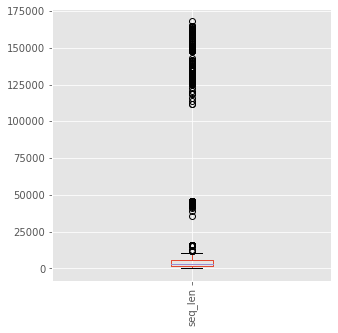

In [142]:
non_vir_df.seq_len.plot(kind='box', rot=90, figsize=(5,5))

In [146]:
# non_vir_df['bins'] = pd.qcut(non_vir_df['seq_len'].values, 10, labels=False)

In [147]:
# non_vir_df.bins.plot(kind='hist')

In [148]:
# non_vir_df.groupby(by='bins').agg({'seq_len': 'mean'})

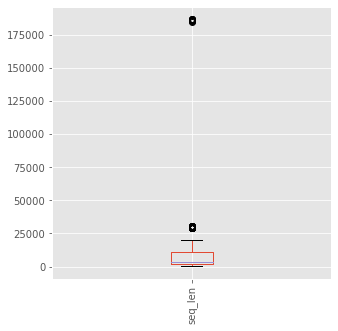

In [149]:
vir_df.seq_len.plot(kind='box', rot=90, figsize=(5,5))

In [150]:
# vir_df['bins'] = pd.qcut(vir_df['seq_len'].values, 10, labels=False)

In [151]:
# vir_df.bins.plot(kind='hist')

In [152]:
# vir_df.groupby(by='bins').agg({'seq_len': 'mean'})

## Sample and concatenate two dataframes

In [ ]:
vir_df_sample = vir_df.sample(n=10000, weights='seq_len', random_state=42)
non_vir_df_sample = non_vir_df.sample(n=10000, weights='seq_len', random_state=42)

In [ ]:
sample_df = pd.concat([vir_df_sample, non_vir_df_sample])
sample_df.reset_index(drop=True, inplace=True)

In [ ]:
sample_df.head()

In [ ]:
sample_df.seq_len.plot(kind='box')

In [153]:
merged_df = pd.concat([vir_df, non_vir_df])

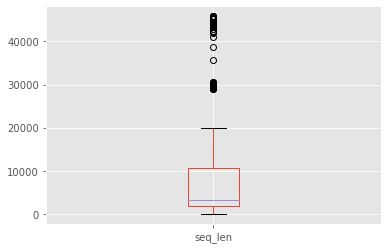

In [181]:
# filtered_df = filterOutliers(merged_df)
filtered_df = merged_df[merged_df.seq_len<=50000]
filtered_df.reset_index(drop=True, inplace=True)
filtered_df.seq_len.plot(kind='box')

## Reconstruct common protein analysis

In [182]:
t1 = time.time()
filtered_df['p_seq'] = filtered_df['seq_str'].apply(lambda x: proteinTranslation(x))
print(f'Took {time.time() - t1} seconds to translate nucleotides to proteins')

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\Bio\Seq.py:2859: BiopythonWarning:

Partial codon, len(sequence) not a multiple of three. Explicitly trim the sequence or add trailing N before translation. This may become an error in future.



Took 112.405606508255 seconds to translate nucleotides to proteins


c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [183]:
filtered_df['gc_content'] = filtered_df['seq_str'].apply(lambda x: calcGcContent(x))

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [184]:
filtered_df.rename(columns={'p_seq': 'protein_sequence', 'seq_str': 'nucleotide_sequence'}, inplace=True)

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\pandas\core\frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [185]:
aa, mw, a, ii = np.apply_along_axis(proteinAnalysis, 0, filtered_df['protein_sequence'].values)
new_cols = ['amino_acid_percents','molecular_weights','aromaticity','instability_index']
filtered_df[new_cols] = pd.DataFrame({'amino_acid_percents': aa, 
                                      'molecular_weights': mw, 
                                      'aromaticity': a, 
                                      'instability_index': ii})

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 43995/43995 [06:27<00:00, 113.48it/s]
c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\pandas\core\frame.py:2963: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [222]:
filtered_df.head()

,seq_name,seq_desc,nucleotide_sequence,class,seq_len,protein_sequence,gc_content,amino_acid_percents,molecular_weights,aromaticity,...,Release_Date,Species,Genus,Family,Length,Nuc_Completeness,Geo_Location,Host,Isolation_Source,Collection_Date
seq_id,,,,,,,,,,,,,,,,,,,,,
MT577359,MT577359.1,MT577359.1 |Severe acute respiratory syndrome ...,CAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTT...,virulent,29816,QPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE ...,38.006,"{'A': 0.0552571782689527, 'C': 0.0309853336087...",1.091393e+06,38.486263,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29816.0,complete,Bangladesh,Homo sapiens,NaN,4/25/2020
MT582456,MT582456.1,MT582456.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.020,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065028e+06,43.949719,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782.0,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/19/2020
MT582458,MT582458.1,MT582458.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,43.920277,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782.0,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/18/2020
MT582459,MT582459.1,MT582459.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065118e+06,43.961120,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782.0,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/18/2020
MT582460,MT582460.1,MT582460.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,43.920277,...,2020-06-09T00:00:00Z,Severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782.0,complete,Germany: Dusseldorf,Homo sapiens,NaN,3/17/2020


In [220]:
filtered_df['seq_id'] = filtered_df['seq_id'].apply(lambda x: x.replace('.1', '').replace('.2', '').replace('.3', '').replace('.4', '').replace('.5', ''))

In [191]:
num_cols = ['molecular_weights', 'aromaticity', 'instability_index']
filtered_df[num_cols] = filtered_df[num_cols].astype('float')

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\pandas\core\frame.py:2963: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [192]:
filtered_df.describe()

,seq_len,gc_content,molecular_weights,aromaticity,instability_index
count,43995.000000,43995.000000,4.399500e+04,43995.000000,43995.000000
mean,6578.015797,44.970452,3.016464e+05,45.963383,0.093918
std,7718.174561,4.948916,3.345605e+05,8.325980,0.022252
min,20.000000,20.000000,6.833177e+03,5.409630,0.014085
25%,1767.000000,41.704500,6.342570e+04,40.203329,0.078313
50%,3215.000000,45.491000,1.173084e+05,46.208502,0.090909
75%,10595.500000,48.613000,3.979021e+05,50.942835,0.106341
max,45781.000000,70.000000,1.116475e+06,86.262727,0.187192


In [221]:
filtered_df.set_index('seq_id', inplace=True)

### Import metadata for pathogenic and nonpathogenic sequences

In [194]:
vir_meta_df = pd.read_csv('pathogenic_sequences_table.csv')
non_vir_meta_df = pd.read_csv('non_pathogenic_sequences_table.csv')

In [203]:
vir_meta_df.set_index('Accession', inplace=True)
vir_meta_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 37465 entries, MT565495 to S50225
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Release_Date      37465 non-null  object
 1   Species           37465 non-null  object
 2   Genus             37445 non-null  object
 3   Family            37465 non-null  object
 4   Length            37465 non-null  int64 
 5   Nuc_Completeness  37465 non-null  object
 6   Geo_Location      35640 non-null  object
 7   Host              33229 non-null  object
 8   Isolation_Source  15258 non-null  object
 9   Collection_Date   33038 non-null  object
dtypes: int64(1), object(9)
memory usage: 3.1+ MB


In [204]:
non_vir_meta_df.set_index('Accession', inplace=True)
non_vir_meta_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 11847 entries, MN734250 to M90541
Data columns (total 10 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Release_Date      11847 non-null  object
 1   Species           11847 non-null  object
 2   Genus             9334 non-null   object
 3   Family            11847 non-null  object
 4   Length            11847 non-null  int64 
 5   Nuc_Completeness  11847 non-null  object
 6   Geo_Location      10676 non-null  object
 7   Host              8162 non-null   object
 8   Isolation_Source  2751 non-null   object
 9   Collection_Date   9498 non-null   object
dtypes: int64(1), object(9)
memory usage: 1018.1+ KB


In [223]:
meta_df = pd.concat([vir_meta_df, non_vir_meta_df])

In [224]:
filtered_df = filtered_df.merge(meta_df, how='left', left_index=True, right_index=True)

In [236]:
filtered_df.to_csv('virus_analysis.csv')

In [230]:
# clean_cols = [col for col in filtered_df.columns.tolist() if not col.__contains__('_x')]
# analysis_df = filtered_df[clean_cols].copy()
# clean_cols = [col.replace('_y', '') for col in clean_cols]
# analysis_df.columns = clean_cols
# analysis_df.head()

### Inspect feature distributions

In [370]:
analysis_df = pd.read_csv('virus_analysis.csv')

In [5]:
analysis_df.isnull().sum()

seq_id                     0
seq_name                   0
seq_desc                   0
nucleotide_sequence        0
class                      0
seq_len                    0
protein_sequence           0
gc_content                 0
amino_acid_percents        0
molecular_weights          0
aromaticity                0
instability_index          0
Release_Date               0
Species                    0
Genus                   2509
Family                     0
Length                     0
Nuc_Completeness           0
Geo_Location            2736
Host                    7294
Isolation_Source       27419
Collection_Date         6100
dtype: int64

In [6]:
analysis_df.drop('Isolation_Source', axis=1, inplace=True)

In [7]:
# filtered_df.dropna(inplace=True)

In [8]:
virus_names = analysis_df.Species.unique().tolist()

In [9]:
virus_names

['Severe acute respiratory syndrome-related coronavirus',
 'Rotavirus A',
 'Rabies lyssavirus',
 'Chikungunya virus',
 'Dengue virus',
 'Hepatitis B virus',
 'Puumala orthohantavirus',
 'West Nile virus',
 'Mumps rubulavirus',
 'Japanese encephalitis virus',
 'Influenza A virus',
 'Perch actinovirus',
 'Andes orthohantavirus',
 'Zika virus',
 'Zaire ebolavirus',
 'Hantaan orthohantavirus',
 'Marburg marburgvirus',
 'Middle East respiratory syndrome-related coronavirus',
 'Measles morbillivirus',
 'Domestic cat hepadnavirus',
 'Tula orthohantavirus',
 'Musk shrew hepatitis B virus',
 'Crowned shrew hepatitis B virus',
 'Bombali ebolavirus',
 'Tai Forest hepadnavirus',
 'Laibin mobatvirus',
 'Shrew hepatitis B virus',
 'Tibetan frog hepatitis B virus',
 'Bat rotavirus',
 'Bundibugyo ebolavirus',
 'Xuan son virus',
 'Rotavirus B',
 'Duck hepatitis B virus',
 'Reston ebolavirus',
 'Ash River virus',
 'Sudan ebolavirus',
 'Tai Forest ebolavirus',
 'Bat hepadnavirus',
 'Rotavirus G',
 'Goose

In [371]:
analysis_df['Species'] = analysis_df['Species'].apply(lambda x: x.lower())

In [11]:
virus_families = analysis_df.Family.unique().tolist()

In [12]:
analysis_df.Family.value_counts()

Orthomyxoviridae    10543
Flaviviridae         6779
Hepadnaviridae       6541
Coronaviridae        2997
Microviridae         2753
Circoviridae         2722
Reoviridae           1951
Geminiviridae        1455
Rhabdoviridae        1419
Paramyxoviridae      1370
Anelloviridae         947
Filoviridae           658
Hantaviridae          618
Togaviridae           543
Potyviridae           471
Secoviridae           449
Picornaviridae        323
Polyomaviridae        271
Tospoviridae          256
Bromoviridae          197
Parvoviridae          195
Dicistroviridae       120
Caulimoviridae        116
Adenoviridae          110
Birnaviridae           91
Retroviridae           37
Virgaviridae           34
Poxviridae             19
Baculoviridae           9
Herpesviridae           1
Name: Family, dtype: int64

In [13]:
pd.crosstab(analysis_df['Family'], analysis_df['class']).sort_values(by='virulent', ascending=False)

class,non-virulent,virulent
Family,,
Orthomyxoviridae,0,10543
Flaviviridae,0,6779
Hepadnaviridae,0,6541
Coronaviridae,0,2997
Reoviridae,220,1731
Rhabdoviridae,0,1419
Paramyxoviridae,318,1052
Filoviridae,0,658
Hantaviridae,0,618


In [14]:
def plotSequenceLenHistogram(df, bins, strain):
    df[(df['Species'].str.contains(strain))]['seq_len'].hist(bins=bins)
    plt.title(f'{strain} Protein Length Distribution')
    plt.show()

In [15]:
virus_names = ['ebola', 'hanta', 'severe acute respiratory', 'influenza', 'rabies', 'dengue', 'hepatitis', 'hepacivirus', 'rota', 'chikungunya', 'west nile', 'zika', 'measles', 'middle east']

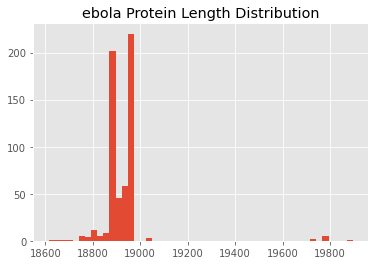

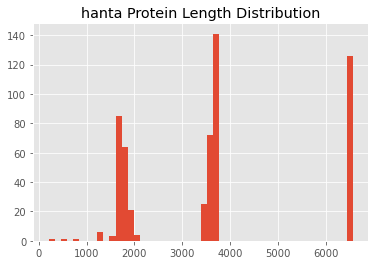

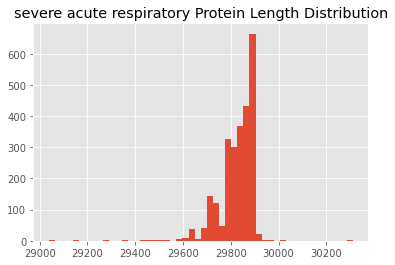

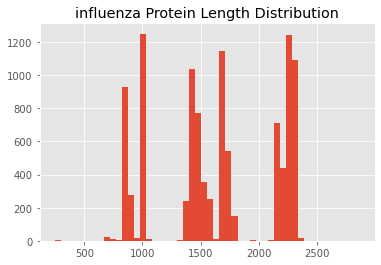

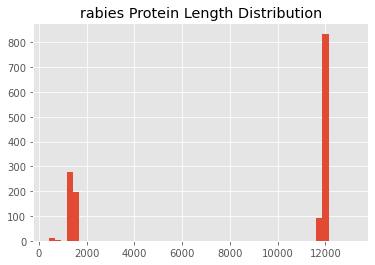

...

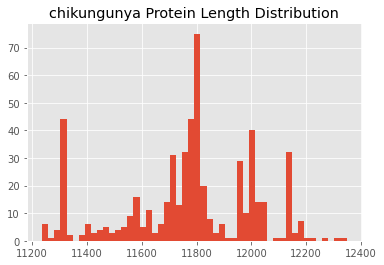

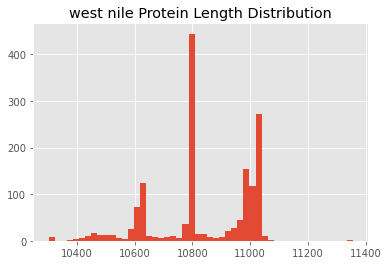

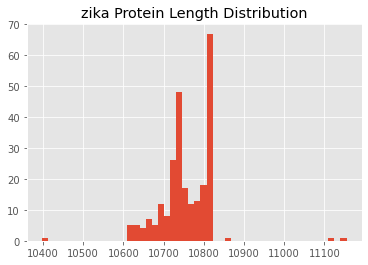

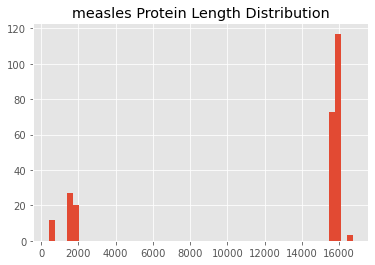

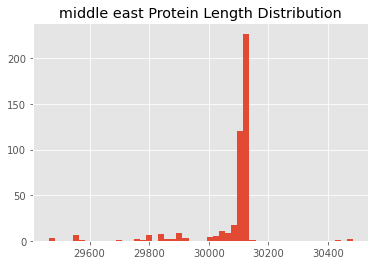

In [16]:
for name in virus_names:
    plotSequenceLenHistogram(analysis_df, 50, name)

In [17]:
analysis_df.describe()

,seq_len,gc_content,molecular_weights,aromaticity,instability_index,Length
count,43995.000000,43995.000000,4.399500e+04,43995.000000,43995.000000,43995.000000
mean,6578.015797,44.970452,3.016464e+05,45.963383,0.093918,6578.015797
std,7718.174561,4.948916,3.345605e+05,8.325980,0.022252,7718.174561
min,20.000000,20.000000,6.833177e+03,5.409630,0.014085,20.000000
25%,1767.000000,41.704500,6.342570e+04,40.203329,0.078313,1767.000000
50%,3215.000000,45.491000,1.173084e+05,46.208502,0.090909,3215.000000
75%,10595.500000,48.613000,3.979021e+05,50.942835,0.106341,10595.500000
max,45781.000000,70.000000,1.116475e+06,86.262727,0.187192,45781.000000


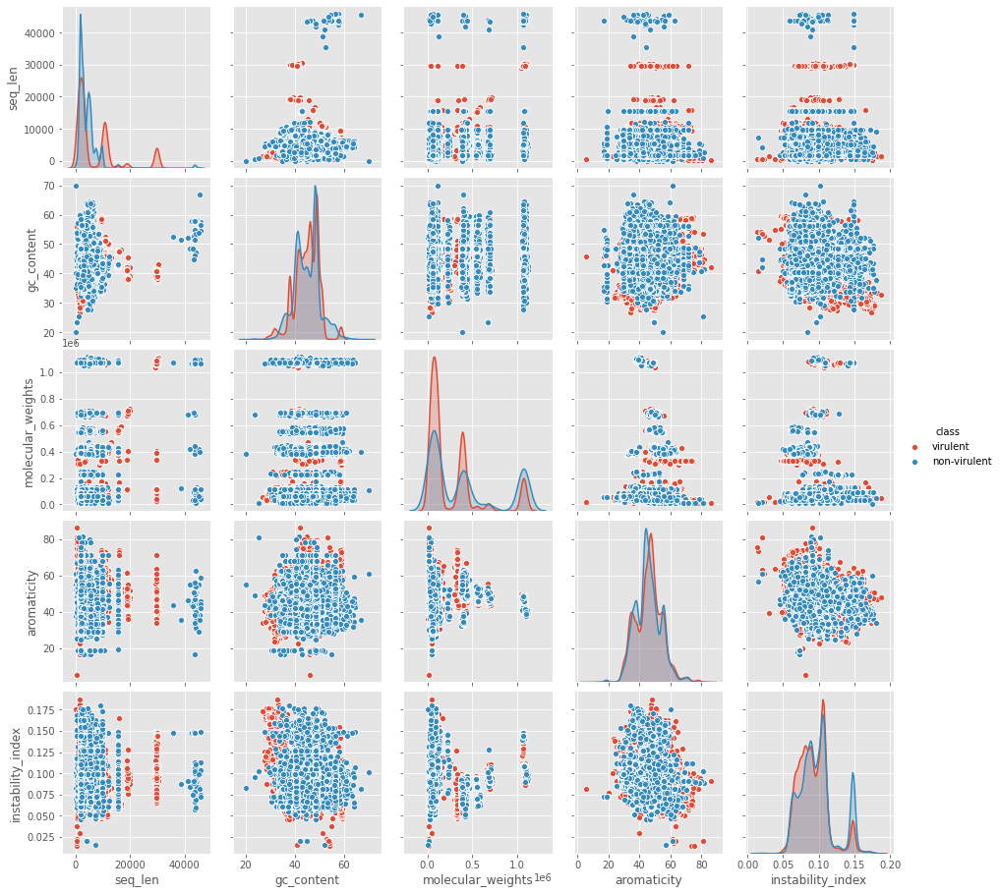

In [18]:
sns.pairplot(data=analysis_df[['seq_len', 'gc_content', 'molecular_weights', 'aromaticity', 'instability_index', 'class']], hue='class')
plt.show()

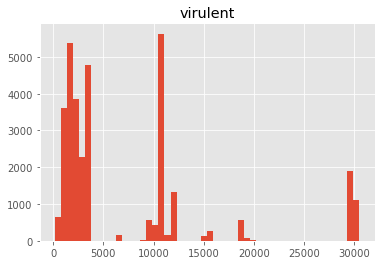

In [19]:
analysis_df[(analysis_df['class']=='virulent')].seq_len.hist(bins=50)
#  & (analysis_df['seq_desc'].str.contains('complete')) & (analysis_df['seq_len']>= 10000)
plt.title('virulent')
plt.show()

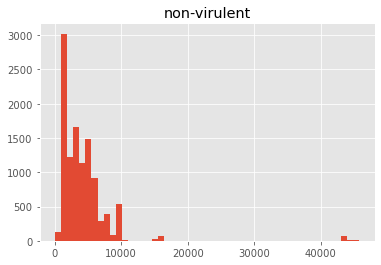

In [20]:
analysis_df[(analysis_df['class']=='non-virulent')].seq_len.hist(bins=50) 
#  & (analysis_df['seq_desc'].str.contains('complete')) & (analysis_df['seq_len'] <= 80000) & (analysis_df['seq_len']>= 10000)
plt.title('non-virulent')
plt.show()

In [21]:
# analysis_df = pd.concat([
#     filtered_df[(filtered_df['class']=='virulent') & (filtered_df['seq_desc'].str.contains('complete')) & (filtered_df['seq_len']>= 10000)],
#     filtered_df[(filtered_df['class']=='non-virulent') & (filtered_df['seq_desc'].str.contains('complete')) & (filtered_df['seq_len'] <= 80000) & (filtered_df['seq_len']>= 10000)]
# ])

In [246]:
analysis_df.head()

,seq_id,seq_name,seq_desc,nucleotide_sequence,class,seq_len,protein_sequence,gc_content,amino_acid_percents,molecular_weights,...,Release_Date,Species,Genus,Family,Length,Nuc_Completeness,Geo_Location,Host,Collection_Date,Country
0,MT577359,MT577359.1,MT577359.1 |Severe acute respiratory syndrome ...,CAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTT...,virulent,29816,QPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE ...,38.006,"{'A': 0.0552571782689527, 'C': 0.0309853336087...",1.091393e+06,...,2020-06-09T00:00:00Z,severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29816,complete,Bangladesh,Homo sapiens,4/25/2020,Bangladesh
1,MT582456,MT582456.1,MT582456.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.020,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065028e+06,...,2020-06-09T00:00:00Z,severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,3/19/2020,Germany
2,MT582458,MT582458.1,MT582458.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,...,2020-06-09T00:00:00Z,severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,3/18/2020,Germany
3,MT582459,MT582459.1,MT582459.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065118e+06,...,2020-06-09T00:00:00Z,severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,3/18/2020,Germany
4,MT582460,MT582460.1,MT582460.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,virulent,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,...,2020-06-09T00:00:00Z,severe acute respiratory syndrome-related coro...,Betacoronavirus,Coronaviridae,29782,complete,Germany: Dusseldorf,Homo sapiens,3/17/2020,Germany


In [253]:
pd.DataFrame(analysis_df['amino_acid_percents'].values.tolist())

,0
0,"{'A': 0.0552571782689527, 'C': 0.0309853336087..."
1,"{'A': 0.04095227694659823, 'C': 0.069345855629..."
2,"{'A': 0.04095227694659823, 'C': 0.069345855629..."
3,"{'A': 0.04095227694659823, 'C': 0.069345855629..."
4,"{'A': 0.04095227694659823, 'C': 0.069345855629..."
...,...
43990,"{'A': 0.034108527131782945, 'C': 0.05736434108..."
43991,"{'A': 0.034108527131782945, 'C': 0.05736434108..."
43992,"{'A': 0.03364389233954451, 'C': 0.055900621118..."
43993,"{'A': 0.03364389233954451, 'C': 0.055900621118..."


In [264]:
import json

In [372]:
analysis_df['amino_acid_percents'] = analysis_df['amino_acid_percents'].apply(lambda x: json.loads(x.replace("'", '"')))

In [374]:
# analysis_df['amino_acid_percents'].apply(pd.Series)

In [284]:
aa_list = list(amino_acids.values())
aa_cols = ['amino_acid_' + aa for aa in aa_list]

In [375]:
amino_acids_percent_df = analysis_df['amino_acid_percents'].apply(pd.Series)
amino_acids_percent_df = amino_acids_percent_df.rename(columns = lambda x : 'amino_acid_' + str(x))

In [376]:
analysis_df = pd.concat([analysis_df, amino_acids_percent_df], axis=1)

In [377]:
analysis_df.columns

Index(['seq_id', 'seq_name', 'seq_desc', 'nucleotide_sequence', 'class',
       'seq_len', 'protein_sequence', 'gc_content', 'amino_acid_percents',
       'molecular_weights', 'aromaticity', 'instability_index', 'Release_Date',
       'Species', 'Genus', 'Family', 'Length', 'Nuc_Completeness',
       'Geo_Location', 'Host', 'Isolation_Source', 'Collection_Date',
       'amino_acid_A', 'amino_acid_C', 'amino_acid_D', 'amino_acid_E',
       'amino_acid_F', 'amino_acid_G', 'amino_acid_H', 'amino_acid_I',
       'amino_acid_K', 'amino_acid_L', 'amino_acid_M', 'amino_acid_N',
       'amino_acid_P', 'amino_acid_Q', 'amino_acid_R', 'amino_acid_S',
       'amino_acid_T', 'amino_acid_V', 'amino_acid_W', 'amino_acid_Y'],
      dtype='object')

## Build TFIDF vectors to proten similarity clustering

In [22]:
protein_corpus = analysis_df.protein_sequence.values

In [63]:
t1 = time.time()

vectorizer = TfidfVectorizer(ngram_range=(1, 10), 
                             analyzer='word', norm='l2', 
                             max_features=5000, lowercase=False,
                             min_df=.01, max_df=.90)
protein_vectors = vectorizer.fit_transform(protein_corpus)

t2 = time.time()

print(f'Took {t2-t1:.3} seconds to build TFIDF vector')

Took 39.6 seconds to build TFIDF vector


In [64]:
protein_vectors.shape

(43995, 5000)

In [25]:
protein_vectors.toarray()[0:5]

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.03177243, 0.03178398, 0.03178398, ..., 0.0317782 , 0.03178398,
        0.03178398],
       [0.03177243, 0.03178398, 0.03178398, ..., 0.0317782 , 0.03178398,
        0.03178398],
       [0.03177243, 0.03178398, 0.03178398, ..., 0.0317782 , 0.03178398,
        0.03178398],
       [0.03177243, 0.03178398, 0.03178398, ..., 0.0317782 , 0.03178398,
        0.03178398]])

In [26]:
vectorizer.get_feature_names()

['ACK',
 'ACK IFGFVC',
 'ACK IFGFVC LYHYWWS',
 'ACK IFGFVC LYHYWWS SLEFR',
 'AFS',
 'AFS QSC YNY',
 'AGCC',
 'AHAY',
 'AINSI',
 'AINSI VWY',
 'AINSI VWY LPR TFGIWCHFCCSST',
 'AINSI VWY LPR TFGIWCHFCCSST RRARRRLVR',
 'AIYN',
 'ARHL',
 'ASTILL',
 'ASTILL YQCTRRFCCL',
 'ASTILL YQCTRRFCCL KFTP',
 'ASTILL YQCTRRFCCL KFTP HTLCAHGWLYYSIS',
 'AVYKMAMVHLARFYSWLDCHSNGDNYALLYDQLL',
 'AWYIYLC',
 'AWYIYLC VHW',
 'AY',
 'CASY',
 'CC',
 'CCNNKDST',
 'CCNNKDST GW',
 'CCNNKDST GW NC',
 'CCNNKDST GW NC LVEAVN',
 'CCNRNCQQHSL',
 'CCP',
 'CCP STDT',
 'CCSRGCFNCCGYTY',
 'CCY',
 'CCY SL',
 'CCY SL ISIL',
 'CCYSV',
 'CCYSV WLSYFFF',
 'CCYSV WLSYFFF NT',
 'CCYSV WLSYFFF NT RTFY NHLTCWFL',
 'CCYSV WLSYFFF NT RTFY NHLTCWFL RLVLFWTIYTTRYRIS',
 'CCYSV WLSYFFF NT RTFY NHLTCWFL RLVLFWTIYTTRYRIS ER',
 'CE',
 'CE LHF',
 'CENYRSCRRHYT',
 'CENYRSCRRHYT TSK',
 'CFIRR',
 'CFRSSHFHVGSYNLCYF',
 'CFSCKHSKRN',
 'CFSCKHSKRN PPQ',
 'CFSCKHSKRN PPQ GCQEFK',
 'CFSNTCRLFNRG',
 'CGGY',
 'CGGY TLHTLF',
 'CGGY TLHTLF ERS IVT TYCLAC'

In [286]:
analysis_df['Country'].value_counts()

China           11348
USA             10268
nan              2736
Viet Nam         1330
India            1263
                ...  
Cyprus              1
Barbados            1
Libya               1
Uzbekistan          1
Cook Islands        1
Name: Country, Length: 181, dtype: int64

In [378]:
analysis_df['Country'] = analysis_df['Geo_Location'].apply(lambda x: str(x).split(':')[0])
analysis_df['Country'] = analysis_df['Country'].replace(np.nan, 'Unknown')

In [287]:
ids = analysis_df.reset_index().seq_id.values
classes = analysis_df['class'].values
species = analysis_df['Species'].values
family = analysis_df['Family'].values
country = analysis_df['Country'].values
amino_acids = analysis_df[aa_cols].values

In [73]:
num_cols = ['seq_len', 'gc_content', 'molecular_weights', 'aromaticity', 'instability_index']
numeric = analysis_df[num_cols].values

scaler = StandardScaler()
numeric_scaled = scaler.fit_transform(numeric)

In [290]:
vector_df = pd.DataFrame(protein_vectors.toarray())
vector_df['ids'] = ids
vector_df['class'] = classes
vector_df['species'] = species
vector_df['family'] = family
vector_df['country'] = country
vector_df[aa_cols] = pd.DataFrame(amino_acids)
vector_df[num_cols] = pd.DataFrame(numeric_scaled)
vector_df.set_index('ids', inplace=True)

In [357]:
vector_df.groupby(['class','family']).size()

class  family          
False  Adenoviridae          110
       Anelloviridae         947
       Baculoviridae           9
       Birnaviridae           91
       Bromoviridae          197
       Caulimoviridae        116
       Circoviridae         2722
       Dicistroviridae       120
       Geminiviridae        1455
       Herpesviridae           1
       Microviridae         2753
       Paramyxoviridae       318
       Parvoviridae          195
       Picornaviridae        323
       Polyomaviridae        271
       Potyviridae           471
       Poxviridae             19
       Reoviridae            220
       Retroviridae           37
       Secoviridae           449
       Tospoviridae          256
       Virgaviridae           34
True   Coronaviridae        2997
       Filoviridae           658
       Flaviviridae         6779
       Hantaviridae          618
       Hepadnaviridae       6541
       Orthomyxoviridae    10543
       Paramyxoviridae      1052
       Reoviridae  

In [ ]:
# vector_df.to_csv('analysis_vectors.csv')

## Cluster and Visualize COVID strains

### Attempt classification on vectors using Gaussian NB

In [27]:
vector_df = pd.read_csv('analysis_vectors.csv')

In [76]:
vector_df.head()

,0,1,2,3,4,5,6,7,8,9,...,4998,4999,class,species,family,seq_len,gc_content,molecular_weights,aromaticity,instability_index
ids,,,,,,,,,,,,,,,,,,,,,
MT577359,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,virulent,severe acute respiratory syndrome-related coro...,Coronaviridae,3.010848,-1.407284,2.360577,-0.898057,0.235258
MT582456,0.000000,0.000000,0.000000,0.000000,0.014217,0.014222,0.014222,0.014222,0.014105,0.014225,...,0.014238,0.014240,virulent,severe acute respiratory syndrome-related coro...,Coronaviridae,3.006442,-1.404455,2.281770,-0.241856,2.444004
MT582458,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.014156,0.014159,virulent,severe acute respiratory syndrome-related coro...,Coronaviridae,3.006442,-1.407284,2.281935,-0.245392,2.448912
MT582459,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.014156,0.014159,virulent,severe acute respiratory syndrome-related coro...,Coronaviridae,3.006442,-1.407284,2.282040,-0.240486,2.448912
MT582460,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,0.014156,0.014159,virulent,severe acute respiratory syndrome-related coro...,Coronaviridae,3.006442,-1.407284,2.281935,-0.245392,2.448912


In [78]:
vec_cols = list(np.arange(1000))
num_cols = ['seq_len', 'gc_content', 'molecular_weights', 'aromaticity', 'instability_index']
cat_cols = ['species', 'family', 'country']

In [81]:
vector_df.groupby(by=['class', 'family', 'species'])[vec_cols].mean().to_csv('class_vec_mean.csv')

## Use simple OLS linear regression and LogisticRegression as baseline performance

In [111]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

In [116]:
vec_cols = list(np.arange(1000))
vec_cols_str = [str(col) for col in vec_cols]
vec_col_str = ' + '.join(vec_cols_str)


In [117]:
# formula_str = f'{target_col} ~ {vec_col_str}'

In [134]:
svd_cols = ['svd_' + str(i+1) for i in np.arange(6)]

In [135]:
svd_cols

['svd_1', 'svd_2', 'svd_3', 'svd_4', 'svd_5', 'svd_6']

In [137]:
target_col = 'class'

In [138]:
x = np.matrix(vector_df[svd_cols].values)
y = np.array(vector_df[target_col].values).reshape(-1, 1)

In [139]:
x.shape

(43995, 6)

In [140]:
y.shape

(43995, 1)

In [141]:
y_bin = []
for i in range(len(y)):
    if y[i] == 'virulent':
        y_bin.append(1)
    else:
        y_bin.append(0)

In [132]:
model = sm.OLS(y_bin, x).fit()
print(model.summary())

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.542
Model:                            OLS   Adj. R-squared (uncentered):              0.539
Method:                 Least Squares   F-statistic:                              171.6
Date:                Thu, 18 Jun 2020   Prob (F-statistic):                        0.00
Time:                        18:47:25   Log-Likelihood:                         -38858.
No. Observations:               43995   AIC:                                  7.832e+04
Df Residuals:                   43694   BIC:                                  8.093e+04
Df Model:                         301                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

In [178]:
model.params

array([-9.37002140e-01, -3.54876560e+12, -3.94553466e+12,  6.33062016e+11,
       -7.52270973e-01,  4.05990333e+11,  3.62956403e+10,  4.23177325e+11,
       -5.85041515e+11,  1.08547940e+11, -1.08547940e+11, -5.09393210e+10,
        1.22642544e+11,  2.65254506e+11,  1.21455061e+11, -2.78358025e-01,
        1.99023796e+11,  7.25862961e+10, -5.09766023e+10, -2.20584066e+11,
        6.69505142e-01, -1.48902713e+11,  7.88106675e-02,  8.94068514e+10,
        6.01258174e+10,  7.48917172e+10,  3.39583447e+11, -1.35455093e+11,
       -4.80686013e+11,  7.91260612e-02, -9.17385469e-02, -1.61055169e+11,
        3.96964840e+10, -2.11779073e+10,  1.71517420e+10, -1.57487774e+10,
        1.31376137e+10, -3.31674295e+10, -7.02908363e+09,  1.85181827e+10,
       -2.52165772e-01,  3.60652060e-01,  3.99154211e-01, -2.11622124e-01,
       -4.20589801e+09, -4.99480622e+10, -7.00065159e+10, -5.23715431e+09,
        3.97569092e+09, -3.08718926e+10, -7.20323912e+09, -1.06508601e+11,
       -9.37559437e+08, -

In [179]:
pval_df = pd.DataFrame({'vector': vec_cols, 'pval': model.pvalues, 'coef': model.params})

In [180]:
pval_df['proteins'] = vectorizer.get_feature_names()

In [182]:
# pval_df[pval_df['pval'] <= .05].to_csv('protein_importance.csv', index=False)
pval_df.to_csv('protein_importance_unfiltered.csv', index=False)

In [143]:
pval_list = pval_df[pval_df['pval'] <= .05]['vector'].tolist()

In [359]:
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix, roc_curve, auc, classification_report
from sklearn.feature_selection import RFE

In [379]:
analysis_df['class'].value_counts()

virulent        32881
non-virulent    11114
Name: class, dtype: int64

In [388]:
vec_cols = list(np.arange(0,5000)) # vec_cols + 
cols_to_drop = ['seq_id','seq_name','seq_desc','nucleotide_sequence','protein_sequence','class','Country','Genus','Species','Family','Length','Nuc_Completeness','Geo_Location','Host','Isolation_Source','Collection_Date','Release_Date','amino_acid_percents']

In [380]:
model_df = analysis_df.copy()

In [381]:
model_df['class'] = model_df['class'] == 'virulent'

In [396]:
model_df.head()

,seq_id,seq_name,seq_desc,nucleotide_sequence,class,seq_len,protein_sequence,gc_content,amino_acid_percents,molecular_weights,...,amino_acid_N,amino_acid_P,amino_acid_Q,amino_acid_R,amino_acid_S,amino_acid_T,amino_acid_V,amino_acid_W,amino_acid_Y,Country
0,MT577359,MT577359.1,MT577359.1 |Severe acute respiratory syndrome ...,CAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTT...,True,29816,QPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE ...,38.006,"{'A': 0.0552571782689527, 'C': 0.0309853336087...",1.091393e+06,...,0.052262,0.034497,0.042243,0.035736,0.072712,0.074055,0.078806,0.010122,0.040797,Bangladesh
1,MT582456,MT582456.1,MT582456.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.020,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065028e+06,...,0.051436,0.031561,0.035274,0.060500,0.088239,0.074042,0.059845,0.028721,0.055040,Germany
2,MT582458,MT582458.1,MT582458.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,...,0.051436,0.031561,0.035164,0.060500,0.088239,0.073933,0.059845,0.028721,0.055040,Germany
3,MT582459,MT582459.1,MT582459.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065118e+06,...,0.051436,0.031561,0.035274,0.060500,0.088239,0.074042,0.059845,0.028721,0.055040,Germany
4,MT582460,MT582460.1,MT582460.1 |Severe acute respiratory syndrome ...,AGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTC...,True,29782,RSVL TNFKICVAVTRLHA CTHAV LITNYCR QDTSNSSIFCRL...,38.006,"{'A': 0.04095227694659823, 'C': 0.069345855629...",1.065083e+06,...,0.051436,0.031561,0.035164,0.060500,0.088239,0.073933,0.059845,0.028721,0.055040,Germany


In [389]:
model_df.drop(cols_to_drop, axis=1).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43995 entries, 0 to 43994
Data columns (total 25 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   seq_len            43995 non-null  int64  
 1   gc_content         43995 non-null  float64
 2   molecular_weights  43995 non-null  float64
 3   aromaticity        43995 non-null  float64
 4   instability_index  43995 non-null  float64
 5   amino_acid_A       43995 non-null  float64
 6   amino_acid_C       43995 non-null  float64
 7   amino_acid_D       43995 non-null  float64
 8   amino_acid_E       43995 non-null  float64
 9   amino_acid_F       43995 non-null  float64
 10  amino_acid_G       43995 non-null  float64
 11  amino_acid_H       43995 non-null  float64
 12  amino_acid_I       43995 non-null  float64
 13  amino_acid_K       43995 non-null  float64
 14  amino_acid_L       43995 non-null  float64
 15  amino_acid_M       43995 non-null  float64
 16  amino_acid_N       439

In [382]:
model_df['class'].value_counts()

True     32881
False    11114
Name: class, dtype: int64

In [424]:
analysis_df['protein_sequence'].iloc[0]

'QPTFDLL ICSLNEL NLCGCHSAACLVHSRSIINN LLSLTGHE LVYLLQAAYNLHPCCSRSSAHLGFVRV PKGKMESLVPGFNEKTHVQLSLPVLQVRDVLVRGFGDSVEEVLSEARQHLKDGTCGLVEVEKGVLPQLEQPYVFIKRSDARTAPHGHVMVELVAELEGIQYGRSGETLGVLVPHVGEIPVAYRKVLLRKNGNKGAGGHSYGADLKSFDLGDELGTDPYEDFQENWNTKHSSGVTRELMRELNGGAYTRYVDNNFCGPDGYPLECIKDLLARAGKASCTLSEQLDFIDTKRGVYCCREHEHEIAWYTERSEKSYELQTPFEIKLAKKFDTFNGECPNFVFPLNSIIKTIQPRVEKKKLDGFMGRIRSVYPVASPNECNQMCLSTLMKCDHCGETSWQTGDFVKATCEFCGTENLTKEGATTCGYLPQNAVVKIYCPACHNSEVGPEHSLAEYHNESGLKTILRKGGRTIAFGGCVFSYVGCHNKCAYWVPRASANIGCNHTGVVGEGSEGLNDNLLEILQKEKVNINIVGDFKLNEEIAIILASFSASTSAFVETVKGLDYKAFKQIVESCGNFKVTKGKAKKGAWNIGEQKSILSPLYAFASEAARVVRSIFSRTLETAQNSVRVLQKAAITILDGISQYSLRLIDAMMFTSDLATNNLVVMAYITGGVVQLTSQWLTNIFGTVYEKLKPVLDWLEEKFKEGVEFLRDGWEIVKFISTCACEIVGGQIVTCAKEIKESVQTFFKLVNKFLALCADSIIIGGAKLKALNLGETFVTHSKGLYRKCVKSREETGLLMPLKAPKEIIFLEGETLPTEVLTEEVVLKTGDLQPLEQPTSEAVEAPLVGTPVCINGLMLLEIKDTEKYCALAPNMMVTNNTFTLKGGAPTKVTFGDDTVIEVQGYKSVNITFELDERIDKVLNEKCSAYTVELGTEVNEFACVVADAVIKTLQPVSELLTPLGIDLDEWSMATYYLFDESGEFKLASHMY

In [417]:
cols_to_drop_w_class = [col for col in cols_to_drop if col != 'class']

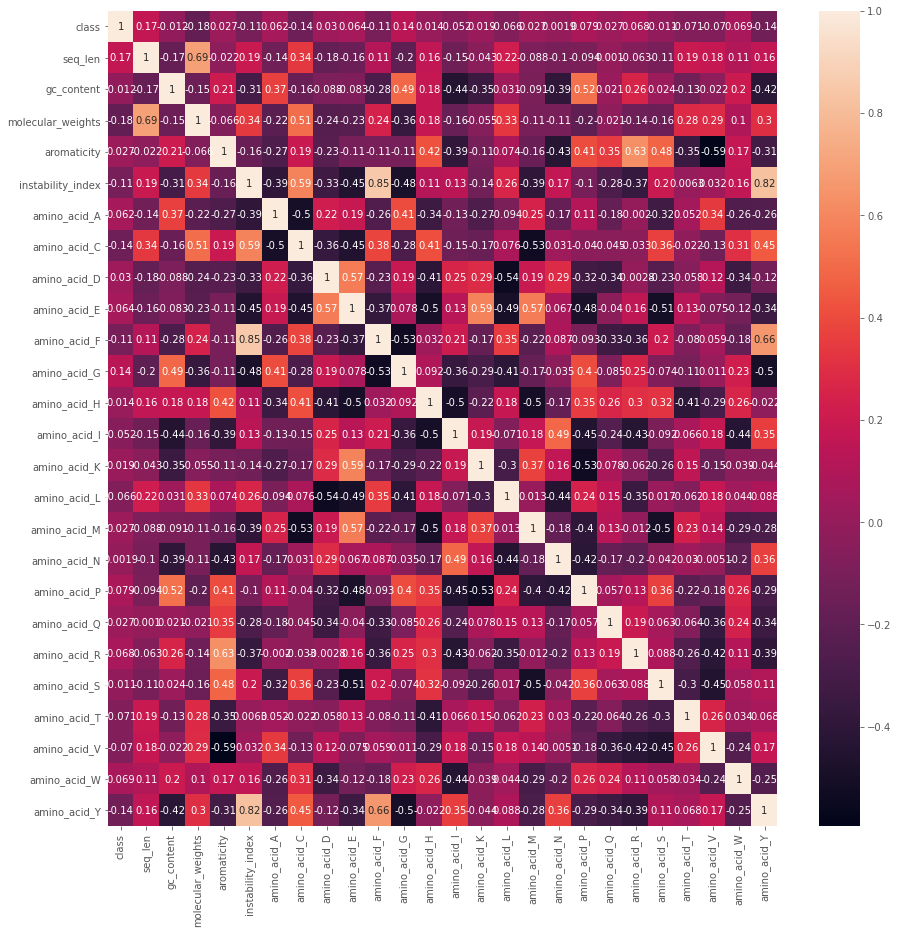

In [423]:
model_corr = model_df.drop(cols_to_drop_w_class, axis=1).corr()
plt.figure(figsize=(15,15))
sns.heatmap(model_corr, annot=True);

In [390]:
X_train, X_test, y_train, y_test = train_test_split(model_df.drop(cols_to_drop, axis=1), model_df['class'], test_size=0.3, random_state=42)

In [392]:
y_test.value_counts()

True     9869
False    3330
Name: class, dtype: int64

In [393]:
etc = ExtraTreesClassifier()
etc.fit(X_train, y_train)
y_pred = etc.predict(X_test)
confusion_matrix(y_test, y_pred)

array([[3212,  118],
       [  72, 9797]], dtype=int64)

In [416]:
etc.score(X_test, y_test)

0.9856049700734905

In [406]:
est = etc.estimators_

In [405]:
importance = etc.feature_importances_

In [420]:
importance

array([0.38362952, 0.2107159 , 0.0780019 , 0.01154166, 0.01597176,
       0.01609906, 0.01537946, 0.01150267, 0.01765605, 0.01567914,
       0.01953115, 0.01458057, 0.01594459, 0.01523737, 0.01622583,
       0.01305666, 0.01440276, 0.01831444, 0.01224417, 0.01374954,
       0.0136153 , 0.01255969, 0.01358702, 0.0139078 , 0.01686598])

In [391]:
X_train.columns

Index(['seq_len', 'gc_content', 'molecular_weights', 'aromaticity',
       'instability_index', 'amino_acid_A', 'amino_acid_C', 'amino_acid_D',
       'amino_acid_E', 'amino_acid_F', 'amino_acid_G', 'amino_acid_H',
       'amino_acid_I', 'amino_acid_K', 'amino_acid_L', 'amino_acid_M',
       'amino_acid_N', 'amino_acid_P', 'amino_acid_Q', 'amino_acid_R',
       'amino_acid_S', 'amino_acid_T', 'amino_acid_V', 'amino_acid_W',
       'amino_acid_Y'],
      dtype='object')

In [408]:
indices = np.argsort(importance)[::-1]

In [410]:
for f in range(X_train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importance[indices[f]]))

1. feature 0 (0.383630)
2. feature 1 (0.210716)
3. feature 2 (0.078002)
4. feature 10 (0.019531)
5. feature 17 (0.018314)
6. feature 8 (0.017656)
7. feature 24 (0.016866)
8. feature 14 (0.016226)
9. feature 5 (0.016099)
10. feature 4 (0.015972)
11. feature 12 (0.015945)
12. feature 9 (0.015679)
13. feature 6 (0.015379)
14. feature 13 (0.015237)
15. feature 11 (0.014581)
16. feature 16 (0.014403)
17. feature 23 (0.013908)
18. feature 19 (0.013750)
19. feature 20 (0.013615)
20. feature 22 (0.013587)
21. feature 15 (0.013057)
22. feature 21 (0.012560)
23. feature 18 (0.012244)
24. feature 3 (0.011542)
25. feature 7 (0.011503)


In [411]:
fig = px.scatter_3d(model_df, x="seq_len", y="gc_content", z="molecular_weights", color="class", opacity=.25,
                 hover_data=['class', 'seq_id', 'Species', 'Family', 'Country'], color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

In [326]:
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred = gnb.predict(X_test)

In [327]:
confusion_matrix(y_test, y_pred, labels=['non-virulent', 'virulent'])

array([[1681, 1649],
       [ 311, 9558]], dtype=int64)

In [328]:
print(classification_report(y_test, y_pred, labels=['non-virulent', 'virulent']))

              precision    recall  f1-score   support

non-virulent       0.84      0.50      0.63      3330
    virulent       0.85      0.97      0.91      9869

    accuracy                           0.85     13199
   macro avg       0.85      0.74      0.77     13199
weighted avg       0.85      0.85      0.84     13199



In [329]:
lrc = LogisticRegression()
lrc.fit(X_train, y_train)

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression()

In [330]:
X_test.columns

Index(['amino_acid_A', 'amino_acid_R', 'amino_acid_N', 'amino_acid_D',
       'amino_acid_C', 'amino_acid_E', 'amino_acid_Q', 'amino_acid_G',
       'amino_acid_H', 'amino_acid_I', 'amino_acid_L', 'amino_acid_K',
       'amino_acid_M', 'amino_acid_F', 'amino_acid_P', 'amino_acid_S',
       'amino_acid_T', 'amino_acid_W', 'amino_acid_Y', 'amino_acid_V',
       'seq_len', 'gc_content', 'molecular_weights', 'aromaticity',
       'instability_index', 'svd_1', 'svd_2', 'svd_3', 'svd_4', 'svd_5',
       'svd_6'],
      dtype='object')

In [331]:
confusion_matrix(y_test, lrc.predict(X_test))

array([[1616, 1714],
       [  35, 9834]], dtype=int64)

In [332]:
selector = RFE(lrc, n_features_to_select=1)
selector = selector.fit(X_train, y_train)

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

c:\users\kenns\miniconda3\envs\data_mining\lib\site-packages\sklearn\linear_model\_logistic.py:764: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

c:\use

In [334]:
selector.ranking_

array([14, 24, 20, 30, 15,  2, 29, 26, 28, 11, 16,  8, 21, 22, 10, 12, 25,
        1, 13, 27,  3,  7,  4, 19,  9,  6, 23, 18, 17,  5, 31])

In [335]:
lrc.coef_

array([[ -1.44725617,   0.9117594 ,   1.45082992,   0.37088087,
         -1.81801691,   4.97212638,  -0.2026358 ,   0.73099948,
          0.5190904 ,  -2.19490743,  -1.25704944,   3.09148991,
          1.69007944,  -1.01430256,  -2.32759977,  -2.63821683,
         -0.8332873 ,   3.07462686,  -2.20087889,  -0.65230795,
        -14.24960489,  -4.0615453 ,  18.49601439,  -2.43180349,
         -7.26796554,  -1.69382301,   1.11273873,   3.35529712,
          2.49033851,  26.45830967,  -0.03567794]])

In [336]:
cols_to_keep = []

In [350]:
Xy = pd.concat([X_train, y_train], axis=1)

In [354]:
Xy['class'] = Xy.loc[:, 'class'] == 'virulent'

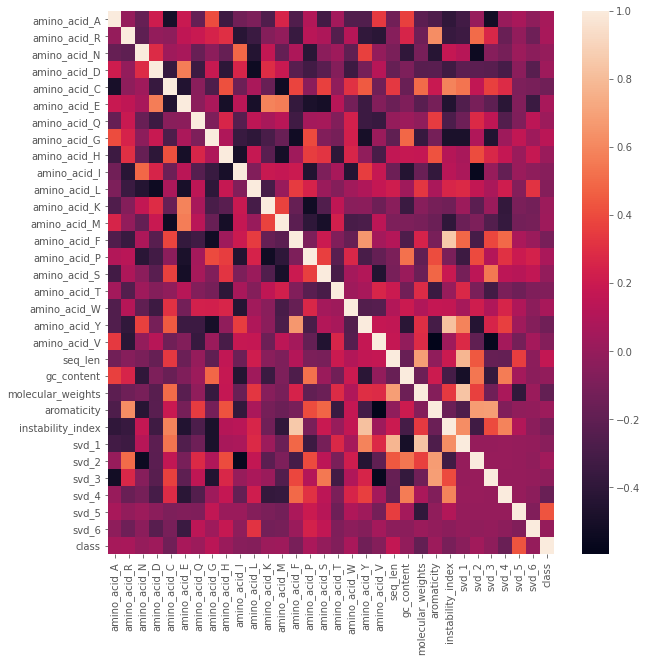

In [355]:
Xy_corr = Xy.corr()
plt.figure(figsize=(10,10))
sns.heatmap(Xy_corr);

In [338]:
mask = np.round(lrc.coef_, decimals=2)>0

In [339]:
for ii, val in enumerate(mask[0]):
    print(ii, val)
    if val == True:
        cols_to_keep.append(X_train.columns.tolist()[ii])

0 False
1 True
2 True
3 True
4 False
5 True
6 False
7 True
8 True
9 False
10 False
11 True
12 True
13 False
14 False
15 False
16 False
17 True
18 False
19 False
20 False
21 False
22 True
23 False
24 False
25 False
26 True
27 True
28 True
29 True
30 False


In [340]:
X_train[cols_to_keep].head()

,amino_acid_R,amino_acid_N,amino_acid_D,amino_acid_E,amino_acid_G,amino_acid_H,amino_acid_K,amino_acid_M,amino_acid_W,molecular_weights,svd_2,svd_3,svd_4,svd_5
ids,,,,,,,,,,,,,,
FJ898464,0.107861,0.065603,0.038416,0.055260,0.091608,0.054669,0.052009,0.016548,0.026005,0.253137,1.144871,-0.053358,-0.524774,0.026349
JF706281,0.061796,0.035704,0.046690,0.059874,0.088712,0.020599,0.054106,0.031035,0.026916,0.301508,0.287595,-2.055400,0.580206,0.246112
JX045969,0.067371,0.063408,0.043593,0.063408,0.060766,0.013210,0.068692,0.048877,0.011889,-0.643210,-0.965462,-0.079412,-0.404688,0.016580
KX831480,0.056190,0.038095,0.023810,0.008571,0.076190,0.042857,0.035238,0.015238,0.022857,-0.553546,-0.204432,0.312849,1.050743,0.106373
KJ545440,0.075922,0.028200,0.015184,0.080260,0.054230,0.041215,0.065076,0.030369,0.036876,-0.741297,0.357401,0.447351,-0.550721,-0.079440


In [342]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(vector_df[cols_to_keep], vector_df['class'], test_size=0.3, random_state=42)

In [343]:
lrc2 = LogisticRegression()
lrc2.fit(X_train2, y_train2)
confusion_matrix(y_test2, lrc2.predict(X_test2))

array([[1339, 1991],
       [  42, 9827]], dtype=int64)

In [344]:
lrc2.score(X_test2, y_test2)

0.8459731797863475

In [345]:
print(classification_report(y_test2, lrc2.predict(X_test2)))

              precision    recall  f1-score   support

       False       0.97      0.40      0.57      3330
        True       0.83      1.00      0.91      9869

    accuracy                           0.85     13199
   macro avg       0.90      0.70      0.74     13199
weighted avg       0.87      0.85      0.82     13199



In [346]:
def plot_roc(X, y, models, model_names):
    plt.figure(0, figsize = [8, 7]).clf()
    plt.plot([0, 1], [0, 1], 'r--')
    plt.xlim([0, 1])
    plt.ylim([0, 1])
    plt.ylabel('True Positive Rate')
    plt.xlabel('False Positive Rate')
    
    for ii, model in enumerate(models):
        y_prob = model.predict_proba(X)[:, 1]
        fpr, tpr, threshold = roc_curve(y, y_prob)
        roc_auc = auc(fpr, tpr)

        plt.plot(fpr, tpr, label = "{} AUC = {:0.2f}".format(model_names[ii], roc_auc))

    plt.legend(loc = 'lower right');

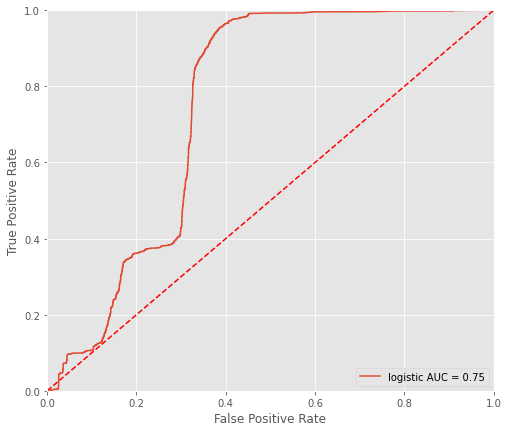

In [347]:
plot_roc(X_test2, y_test2, [lrc2], ['logistic'])

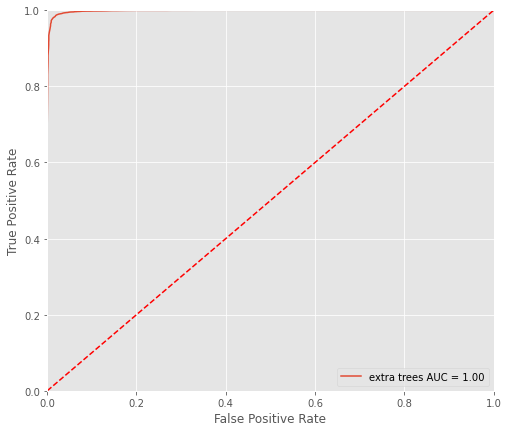

In [394]:
plot_roc(X_test, y_test, [etc], ['extra trees'])

In [182]:
log_coef = lrc.coef_
kept_feat = np.round(lrc.coef_, decimals=2)>0.5

In [183]:
log_coef = log_coef.reshape(-1,)

In [184]:
log_coef.shape

(12,)

In [185]:
kept_feat = kept_feat.reshape(-1,)

In [186]:
kept_feat.shape

(12,)

In [256]:
proteins = np.array(vectorizer.get_feature_names())#.reshape(-1,1)

In [257]:
proteins.shape

(1000,)

In [252]:
lgrc_feat_df = pd.DataFrame()

In [258]:
lgrc_feat_df['column'] = vec_cols
lgrc_feat_df['keep'] = kept_feat
lgrc_feat_df['coef'] = log_coef
lgrc_feat_df['proteins'] = proteins

In [260]:
lgrc_feat_df[lgrc_feat_df['keep']==True].sort_values(by='coef', ascending=False)

,column,keep,coef,proteins
920,920,True,4.769093,WC
248,248,True,4.372430,HQ
701,701,True,4.303440,RSLY
856,856,True,4.042660,TTRQVP
413,413,True,3.629079,LD
...,...,...,...,...
315,315,True,0.626809,ISSKRTN
316,316,True,0.626809,ISSKRTN NV
935,935,True,0.511203,WFMW
936,936,True,0.511203,WFMW CWF


In [261]:
coef_list = lgrc_feat_df[lgrc_feat_df['keep']==True]['column'].tolist()
log_model_df = vector_df[coef_list + num_cols + ['class']].copy()

In [262]:
X_train, X_test, y_train, y_test = train_test_split(log_model_df.drop('class', axis=1), model_df['class'], test_size=0.3, random_state=42)

In [263]:
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred = gnb.predict(X_test)

In [264]:
confusion_matrix(y_test, y_pred, labels=['non-virulent', 'virulent'])

array([[3304,   26],
       [7131, 2738]], dtype=int64)

In [265]:
print(classification_report(y_test, y_pred, labels=['non-virulent', 'virulent']))

              precision    recall  f1-score   support

non-virulent       0.32      0.99      0.48      3330
    virulent       0.99      0.28      0.43      9869

    accuracy                           0.46     13199
   macro avg       0.65      0.63      0.46     13199
weighted avg       0.82      0.46      0.45     13199



### Dimensionality reduction using SVD (Singular Value Decomposition)

In [82]:
protein_vectors.toarray().shape

(43995, 5000)

In [314]:
svd_df = vector_df.drop(['class', 'species', 'family', 'country'], axis=1)
# svd_df.set_index('ids', inplace=True)

In [49]:
# svd_features = np.concatenate((protein_vectors.toarray(), vector_df[num_cols].values), axis=1) # with numeric features
svd_features = protein_vectors.toarray() # without numeric features

In [304]:
# https://chrisalbon.com/machine_learning/feature_engineering/select_best_number_of_components_in_tsvd/
# Create a function
def select_n_components(var_ratio, goal_var: float) -> int:
    # Set initial variance explained so far
    total_variance = 0.0
    
    # Set initial number of features
    n_components = 0
    
    # For the explained variance of each feature:
    for explained_variance in var_ratio:
        
        # Add the explained variance to the total
        total_variance += explained_variance
        
        # Add one to the number of components
        n_components += 1
        
        # If we reach our goal level of explained variance
        if total_variance >= goal_var:
            # End the loop
            break
            
    # Return the number of components
    return n_components

In [91]:
svd_df.shape

(43995, 5005)

In [305]:
tsvd = TruncatedSVD(n_components=30)
X_tsvd = tsvd.fit(svd_df)

In [315]:
tsvd_var_ratios = tsvd.explained_variance_ratio_

In [316]:
select_n_components(tsvd_var_ratios, 0.95)

23

In [308]:
svd = TruncatedSVD(n_components=6, random_state=42)
svd_matrix = svd.fit_transform(svd_df)

In [319]:
tsvd_range = np.arange(1,31)

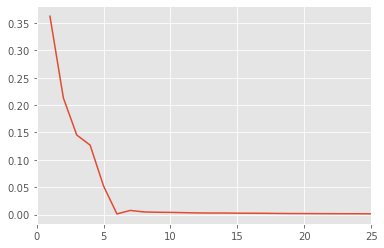

In [320]:
plt.plot(tsvd_range, tsvd_var_ratios)
plt.xlim(0,25)
plt.show()

In [321]:
for i in range(0,6):
    svd_col = 'svd_' + str(i+1)
    vector_df[svd_col] = svd_matrix[:, i]

In [36]:
# vector_df['svd_1'] = svd_matrix[:, 0]
# vector_df['svd_2'] = svd_matrix[:, 1]
# vector_df['svd_3'] = svd_matrix[:, 2]

In [111]:
# vector_df[['svd_1', 'svd_2', 'svd_3', 'species', 'class']]

In [322]:
vector_df.head()

,0,1,2,3,4,5,6,7,8,9,...,gc_content,molecular_weights,aromaticity,instability_index,svd_1,svd_2,svd_3,svd_4,svd_5,svd_6
ids,,,,,,,,,,,,,,,,,,,,,
MT577359,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-1.407284,2.360577,-0.898057,0.235258,3.842633,0.731063,-0.957333,-1.222876,0.250256,0.389143
MT582456,0.000000,0.000000,0.000000,0.000000,0.014217,0.014222,0.014222,0.014222,0.014105,0.014225,...,-1.404455,2.281770,-0.241856,2.444004,4.651941,0.429649,0.557334,0.293284,0.739440,0.175350
MT582458,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,-1.407284,2.281935,-0.245392,2.448912,4.656181,0.424690,0.558075,0.295196,0.740473,0.175480
MT582459,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,-1.407284,2.282040,-0.240486,2.448912,4.655318,0.427762,0.561760,0.294776,0.740226,0.175416
MT582460,0.014148,0.014151,0.014154,0.014156,0.014136,0.014141,0.014141,0.014141,0.014025,0.014143,...,-1.407284,2.281935,-0.245392,2.448912,4.656181,0.424690,0.558075,0.295196,0.740473,0.175480


### Clustering using Kmeans (optional)

In [113]:
ssd = []

for i in range(1, 40):
    print(f'Building kmeans with {i+1} clusters')
    kmeans = KMeans(n_clusters=i+1)
    kmeans.fit(svd_matrix)
    print(f'Current sum of squared distance: {kmeans.inertia_:.2}')
    ssd.append(kmeans.inertia_)
    print('-'*100)

Building kmeans with 2 clusters
Current sum of squared distance: 1.6e+05
----------------------------------------------------------------------------------------------------
Building kmeans with 3 clusters
Current sum of squared distance: 1.3e+05
----------------------------------------------------------------------------------------------------
Building kmeans with 4 clusters
Current sum of squared distance: 1.1e+05
----------------------------------------------------------------------------------------------------
Building kmeans with 5 clusters
Current sum of squared distance: 9.3e+04
----------------------------------------------------------------------------------------------------
Building kmeans with 6 clusters
Current sum of squared distance: 8e+04
----------------------------------------------------------------------------------------------------
Building kmeans with 7 clusters
Current sum of squared distance: 6.9e+04
-----------------------------------------------------------

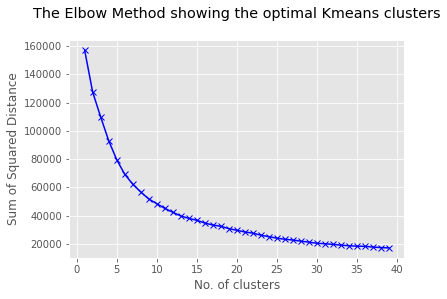

In [114]:
#Plotting to find the number of clusters
plt.plot(range(1,40), ssd,'bx-')
plt.xlabel("No. of clusters")
plt.ylabel("Sum of Squared Distance") #sum of squares within clusters
plt.title("The Elbow Method showing the optimal Kmeans clusters\n")
plt.show()

In [45]:
kmeans = KMeans(n_clusters=30)
kmeans.fit(vector_df)

KMeans(n_clusters=20)

In [47]:
vector_df['cluster'] = kmeans.predict(vector_df)

In [116]:
k_max = 40
k_range = range(1, k_max+1)

# Cluster data into k=1..k_max clusters.
ests = [KMeans(n_clusters=k).fit(svd_matrix) for k in k_range]

In [119]:
from scipy.spatial.distance import cdist, pdist

In [122]:
def get_dists(X, centroids):
    """Calculate distance of each instance from nearest centroid."""
    dists = [cdist(X, center, 'euclidean') for center in centroids]
    dist = [np.min(dist, axis=1) for dist in dists]
    c_idx = [np.argmin(dist, axis=1) for dist in dists]
    
    return dist, c_idx


def get_metrics(X, dist):
    """Cluster "goodness" metrics."""
    total_within_ss = [sum(d**2) for d in dist]  # total within-cluster sum of squares
    total_ss = sum(pdist(X)**2) / X.shape[0]     # total sum of squares
    between_ss = total_ss - total_within_ss      # between-cluster sum of squares
    
    return total_ss, between_ss


def plot_elbow(k_range, total_ss, between_ss, n_true=None):
    """Plot elbow curve."""
    fig = plt.figure(figsize=(10, 8))

    var_exps = (between_ss / total_ss) * 100

    ax = fig.add_subplot(111)
    ax.plot(k_range, var_exps, 'b*-')

    if n_true is not None:
        # Add marker for ground truth.
        kwargs = {'marker': 'o', 'markersize': 12, 'markeredgewidth': 2,
                  'markeredgecolor': 'r', 'markerfacecolor': 'None'}
        k_true = k_range[n_true-1]
        k_true_var_exp = (between_ss[n_true-1] / total_ss) * 100
        ax.plot(k_true, k_true_var_exp, **kwargs)

    ax.set_xlim((0, k_range[-1]))
    ax.set_ylim((0, 100))
    ax.set_xticks(k_range)

    plt.grid(True)
    plt.xlabel("Number of Clusters")
    plt.ylabel("Variance Explained (%)")
    plt.title("k-Means Clustering Elbow Plot")

    plt.show()

In [ ]:
centroids = [est.cluster_centers_ for est in ests]

In [ ]:
dist, c_idx = get_dists(svd_matrix, centroids)
total_ss, between_ss = get_metrics(svd_matrix, dist)

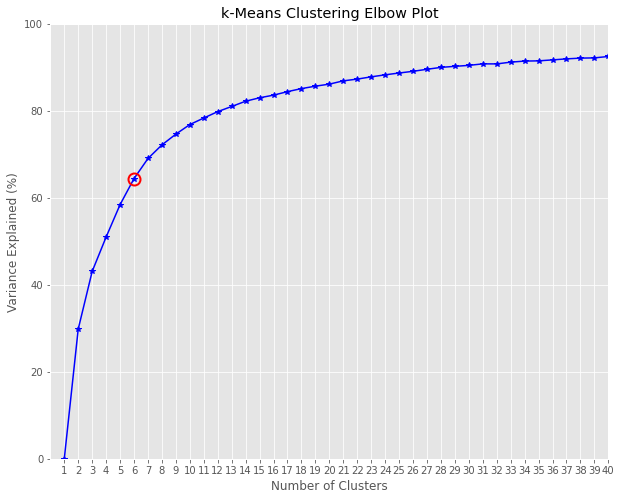

In [125]:
plot_elbow(k_range, total_ss, between_ss, n_true=6)

## Scatterplot of decomposed features with cluster, class and species, etc.

In [150]:
import plotly.express as px
fig = px.scatter_3d(vector_df.reset_index(), x="svd_2", y="svd_5", z='svd_6', color="class", opacity=.25,
                 hover_data=['class', 'ids', 'species', 'family', 'country'], color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

In [50]:
def plot_dendrogram(model, **kwargs):
    children = model.children_
    dist = np.arange(children.shape[0])+1
    n_obs = np.arange(2, children.shape[0]+2)
    linkage_matrix = np.column_stack([children, dist, n_obs])
    dendrogram(linkage_matrix.astype(float), **kwargs)

In [51]:
n_species = vector_df['species'].nunique()
n_species

799

In [58]:
vector_df.family.head()

AttributeError: 'DataFrame' object has no attribute 'family'

In [53]:
X_vect = vector_df[['svd_1', 'svd_2', 'svd_3', 'cluster']].copy()

In [56]:
model = AgglomerativeClustering(n_clusters=n_species)
model = model.fit(X_vect)

In [ ]:
figure = plt.figure(figsize=(12, 200))
labels = vector_df['species'].values
plt.title('Hierarchical Clustering Dendrogram of Virus RNA')
plot_dendrogram(model, labels=labels, orientation='right', leaf_font_size=9)
plt.savefig('species_svd_dendrogram.png')
plt.show()

In [60]:
plt.savefig('species_svd_dendrogram.png')

<Figure size 432x288 with 0 Axes>